# **Tabular Playground Series - Jul 2022**

- https://www.kaggle.com/competitions/tabular-playground-series-jul-2022/overview

#### **BRIEF**
For this challenge, you are given (simulated) manufacturing control data that can be clustered into different control states. Your task is to cluster the data into these control states. You are not given any training data, and you are not told how many possible control states there are. This is a completely unsupervised problem, one you might encounter in a real-world setting.

---

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

sns.set_style("darkgrid")
plt.style.use('seaborn-darkgrid')

pd.set_option('display.max_columns', None)
os.listdir('./data')

df = pd.read_csv('./data/data.csv', index_col=[0])
display(pd.DataFrame(df.dtypes).T )
display(df.head(5))

print( 'DATASET LENGTH: {}'.format(len(df)                 )) # 98000
print( 'MISSING VALUES: {}'.format(np.sum(df.isna().sum()) )) # 0
print( 'DUPLICATES    : {}'.format(df.duplicated().sum()   )) # 0
print( 'NUM OF COLS   : {}'.format(len(df.columns)         )) # 29

,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,f_09,f_10,f_11,f_12,f_13,f_14,f_15,f_16,f_17,f_18,f_19,f_20,f_21,f_22,f_23,f_24,f_25,f_26,f_27,f_28
0,float64,float64,float64,float64,float64,float64,float64,int64,int64,int64,int64,int64,int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64


,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,f_09,f_10,f_11,f_12,f_13,f_14,f_15,f_16,f_17,f_18,f_19,f_20,f_21,f_22,f_23,f_24,f_25,f_26,f_27,f_28
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,-0.389420,-0.912791,0.648951,0.589045,-0.830817,0.733624,2.258560,2,13,14,5,13,6,6,-0.469819,0.358126,1.068105,-0.559650,-0.366905,-0.478412,-0.757002,-0.763635,-1.090369,1.142641,-0.884274,1.137896,1.309073,1.463002,0.813527
1,-0.689249,-0.453954,0.654175,0.995248,-1.653020,0.863810,-0.090651,2,3,6,4,6,16,9,0.591035,-0.396915,0.145834,-0.030798,0.471167,-0.428791,-0.089908,-1.784204,-0.839474,0.459685,1.759412,-0.275422,-0.852168,0.562457,-2.680541
2,0.809079,0.324568,-1.170602,-0.624491,0.105448,0.783948,1.988301,5,11,5,8,9,3,11,-0.679875,0.469326,0.349843,-0.288042,0.291470,-0.413534,-1.602377,1.190984,3.267116,-0.088322,-2.168635,-0.974989,1.335763,-1.110655,-3.630723
3,-0.500923,0.229049,0.264109,0.231520,0.415012,-1.221269,0.138850,6,2,13,8,9,6,4,-0.389456,0.626762,-1.074543,-1.521753,-1.150806,0.619283,1.287801,0.532837,1.036631,-2.041828,1.440490,-1.900191,-0.630771,-0.050641,0.238333
4,-0.671268,-1.039533,-0.270155,-1.830264,-0.290108,-1.852809,0.781898,8,7,5,3,1,13,11,-0.120743,-0.615578,-1.064359,0.444142,0.428327,-1.628830,-0.434948,0.322505,0.284326,-2.438365,1.473930,-1.044684,1.602686,-0.405263,-1.987263


DATASET LENGTH: 98000
MISSING VALUES: 0
DUPLICATES    : 0
NUM OF COLS   : 29


# **EDA**

## Univariate Analysis

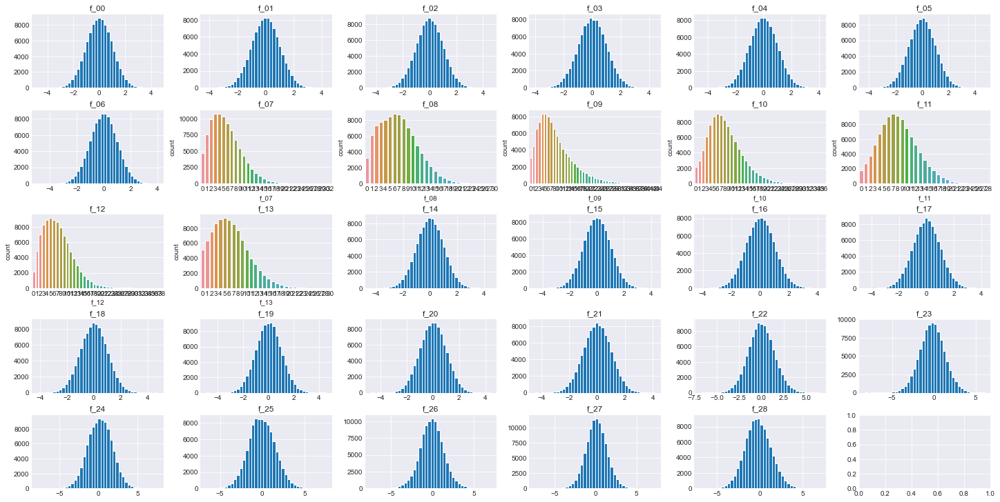

In [2]:
fig, axs = plt.subplots(5, 6, figsize=(20,10), constrained_layout=True)
for col, ax in zip(df.columns, axs.ravel()):
    if df[col].dtype=='float64':
        ax.hist(df[col], bins=40)
    else:
        sns.countplot(x=df[col], ax=ax)
    ax.set_title(col)
plt.show()

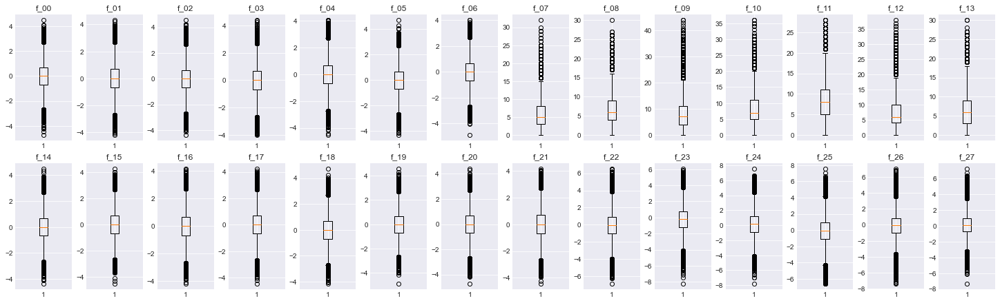

In [38]:
def plot_boxplots(df, grid=(1,1), figsize=(20,6)):
    fig, axs = plt.subplots(grid[0], grid[1], figsize=figsize, constrained_layout=True)
    for col, ax in zip(df.columns, axs.ravel()):
        ax.boxplot(df[col])
        ax.set_title(col)
    plt.show()
plot_boxplots(df, (2,14), (20,6))

#### **Distribution Hypotheses Tests : are distributions normal? poisson/binomial?**

##### **Shapiro-Wilk Test for Normality for continuous features** 

**Shapiro-Wilk Test** (Copied from [Francisco Javier Gallego & Torch me](https://www.kaggle.com/code/javigallego/outliers-eda-clustering-tutorial))

This test is used to test whether a dataset is distributed **normally** or not. The null hypothesis is that a sample $$x_1\hspace{0.1cm},\hspace{0.1cm}\cdots\hspace{0.1cm},\hspace{0.1cm}x_n$$ comes from a normally distributed population. It was published in 1965 by Samuel Shapiro and Martin Wilk and **is considered to be one of the most powerful tests for normality testing.** The test statistic is 

$$W = \frac{(\sum_{i=1}^{n}a_{i}x_i)^2}{\sum_{i=1}^{n}(x_i - \bar{x})^2}$$

where

* $x_i$ is the number from the i-th data point (where the sample is ordered from smallest to largest).
* $\bar{x}$ is the sample mean. 
* Variables $a_i$ are calculated via

$$(a_1, ... , a_n) = \frac{m^T V^{-1}}{(m^T V^{-1}V^{-1}m)^{1/2}} \hspace{2cm}m = (m_1 , ... , m_n)$$

where $m_1 , ... , m_n$ are the mean values of the ordered statistic, of independent and identically distributed random variables, sampled from normal distributions and $V$ denotes the covariance matrix of that order statistic. **The null hypothesis is rejected if W is too small. The value of W can range from 0 to 1.**

In [4]:
from scipy.stats import shapiro
from termcolor import colored

# Univariate normality test
for col in df.columns:
    stat, p_value = shapiro(df[col])
    alpha = 0.05    # significance level
    if p_value > alpha: 
        result = colored('Accepted', 'green')
    else:
        result = colored('Rejected','red')        
    print('Feature: {}\t p-value: {:.4f}\t Hypothesis: {}'.format(col, p_value, result))

Feature: f_00	 p-value: 0.8048	 Hypothesis: Accepted
Feature: f_01	 p-value: 0.9558	 Hypothesis: Accepted
Feature: f_02	 p-value: 0.7717	 Hypothesis: Accepted
Feature: f_03	 p-value: 0.5071	 Hypothesis: Accepted
Feature: f_04	 p-value: 0.4265	 Hypothesis: Accepted
Feature: f_05	 p-value: 0.9887	 Hypothesis: Accepted
Feature: f_06	 p-value: 0.3011	 Hypothesis: Accepted
Feature: f_07	 p-value: 0.0000	 Hypothesis: Rejected
Feature: f_08	 p-value: 0.0000	 Hypothesis: Rejected
Feature: f_09	 p-value: 0.0000	 Hypothesis: Rejected
Feature: f_10	 p-value: 0.0000	 Hypothesis: Rejected
Feature: f_11	 p-value: 0.0000	 Hypothesis: Rejected
Feature: f_12	 p-value: 0.0000	 Hypothesis: Rejected
Feature: f_13	 p-value: 0.0000	 Hypothesis: Rejected
Feature: f_14	 p-value: 0.5630	 Hypothesis: Accepted
Feature: f_15	 p-value: 0.7479	 Hypothesis: Accepted
Feature: f_16	 p-value: 0.6559	 Hypothesis: Accepted
Feature: f_17	 p-value: 0.9626	 Hypothesis: Accepted
Feature: f_18	 p-value: 0.7957	 Hypothesis: Ac

c:\Anaconda\envs\python\lib\site-packages\scipy\stats\_morestats.py:1761: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


##### **Poisson Dispersion Test for discrete features**

This test is used to determine whether a feature is distributed according to a **Poisson** distribution or not. The null hypothesis is that 

$$
X_i \sim Po(\lambda) \quad \text{for every i=1, $\ldots$, n}
$$

This is the **most common** test used for verifying a Poisson distribution. The test statistic (called dispersion) is

$$
D = \sum_{i=1}^{n} \frac{(X_i - \bar{X})^2}{\bar{X}},
$$

where

* $X_i$ is the number from the i-th sample point (order doesn't matter)
* $\bar{X}$ is the sample mean.

Note that the **expected value** of this statistic is $\mathbb{E}(D) = \frac{(n-1) Var(X_i)}{E(X_i)} = \frac{(n-1) \lambda}{\lambda}  = n-1$, since the mean and variance of a Poisson distribution is the rate $\lambda$. If $D$ is too '**far away**' from the expected value of $n-1$, then we **reject** the null hypothesis. 

More formally, $D$ has a **chi-squared** distribution with $n-1$ **degrees of freedom** under the null hypothesis. We determine the **critical values** by using a **two-tailed** test with significance level $\alpha=5\%$.

In [5]:
from scipy.stats import chi2

intcols = [c for c in df.columns if df[c].dtype=='int64']

# Univariate poisson test
for col in df[intcols].columns:
    # Parameters
    alpha = 0.05      
    n = len(df[col])  
    dof = n-1         
    
    # Statistics
    mean = df[col].mean()               # sample mean
    D = ((df[col]-mean)**2).sum()/mean    # test statistic
    
    # Two-tailed test
    q_lower = alpha/2
    q_upper = (1-alpha)/2
    
    # percentile point function = inverse of cdf
    chi2_crit_lower = chi2.ppf(q_lower, dof)
    chi2_crit_upper = chi2.ppf(q_upper, dof)
    
    if (D<chi2_crit_lower) or (D>chi2_crit_upper):
        result = colored('Rejected',  'red')
    else:
        result = colored('Accepted', 'green')
    print('Feature: {}\t Hypothesis: {}'.format(col, result))
    

Feature: f_07	 Hypothesis: Rejected
Feature: f_08	 Hypothesis: Rejected
Feature: f_09	 Hypothesis: Rejected
Feature: f_10	 Hypothesis: Rejected
Feature: f_11	 Hypothesis: Rejected
Feature: f_12	 Hypothesis: Rejected
Feature: f_13	 Hypothesis: Rejected


#### **QQ Plots**

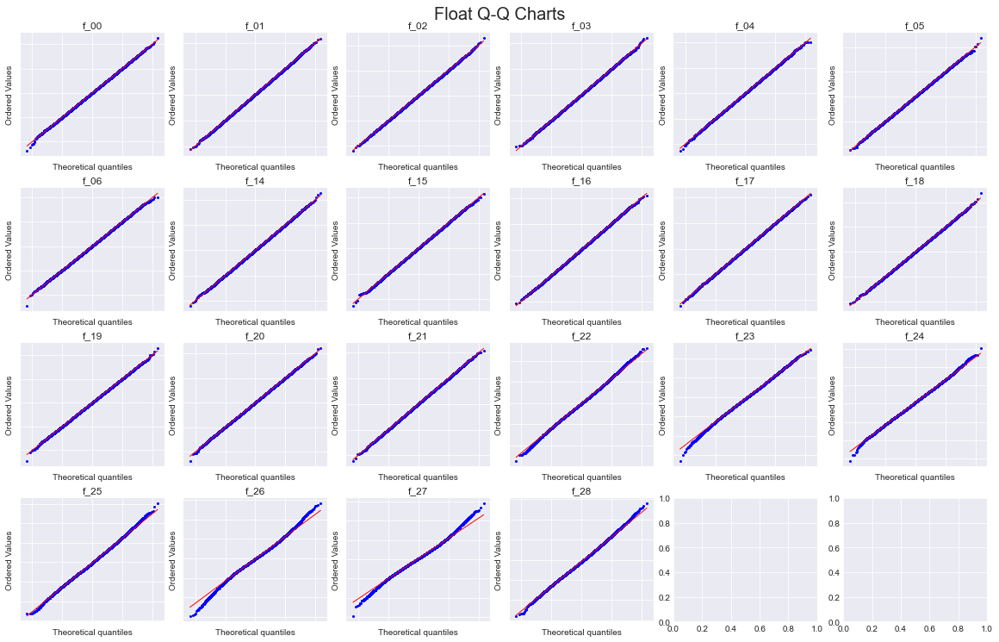

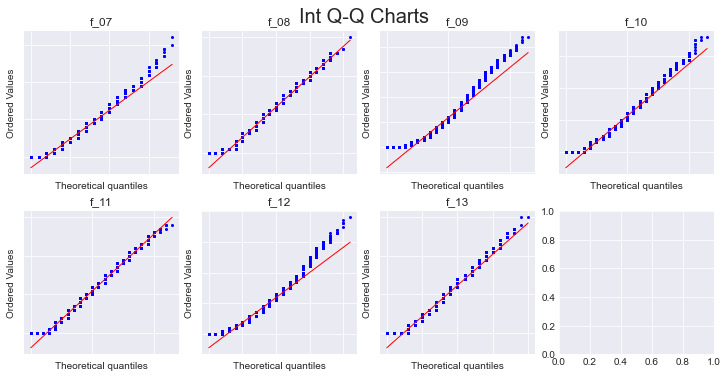

In [6]:
from scipy import stats

floatcols = [c for c in df.columns if df[c].dtype=='float64']

# Continuous
fig, axs = plt.subplots(4,6, constrained_layout=True, figsize=(16,10))
for col,ax in zip(floatcols,axs.ravel()):
    
    # Q-Q plot
    stats.probplot(df[col], dist='norm', plot=ax)
    
    # Aesthetics
    ax.get_lines()[0].set_markersize(2)
    ax.get_lines()[1].set_linewidth(1)
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_title(col)
    
plt.suptitle('Float Q-Q Charts', y=1.02, fontsize=20)
plt.show()

# Discrete 
fig, axs = plt.subplots(2,4, constrained_layout=True, figsize=(10,5))
for col,ax in zip(intcols,axs.ravel()):
    
    # Q-Q plot
    mean = df[col].mean()
    stats.probplot(df[col], dist='poisson', sparams=(mean,), plot=ax)
    
    # Aesthetics
    ax.get_lines()[0].set_markersize(2)
    ax.get_lines()[1].set_linewidth(1)
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_title(col)
    
plt.suptitle('Int Q-Q Charts', y=1.02, fontsize=20)
plt.show()



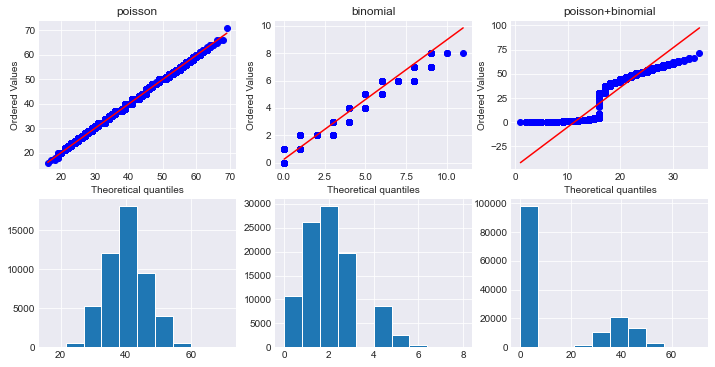

In [7]:
### QUICK THEORETICAL PLOTS FOR UNDERSTANDING/COMPARISON

from scipy import stats

poisson = np.random.poisson(40,50000)
pmean = poisson.mean()

binom = np.random.binomial(10,0.2,98000)
bmean = binom.mean()

combined = np.append(poisson, binom)
cmean = combined.mean()

fig, ax = plt.subplots(2,3,figsize=(12,6))
stats.probplot(poisson,  dist='poisson', sparams=(pmean),       plot=ax[0,0])
stats.probplot(binom,    dist='poisson', sparams=(bmean),  plot=ax[0,1])
stats.probplot(combined, dist='poisson', sparams=(cmean),       plot=ax[0,2])
ax[0,0].set_title('poisson')
ax[0,1].set_title('binomial')
ax[0,2].set_title('poisson+binomial')
ax[1,0].hist(poisson)
ax[1,1].hist(binom)
ax[1,2].hist(combined)


plt.show()

## Bivariate Analysis

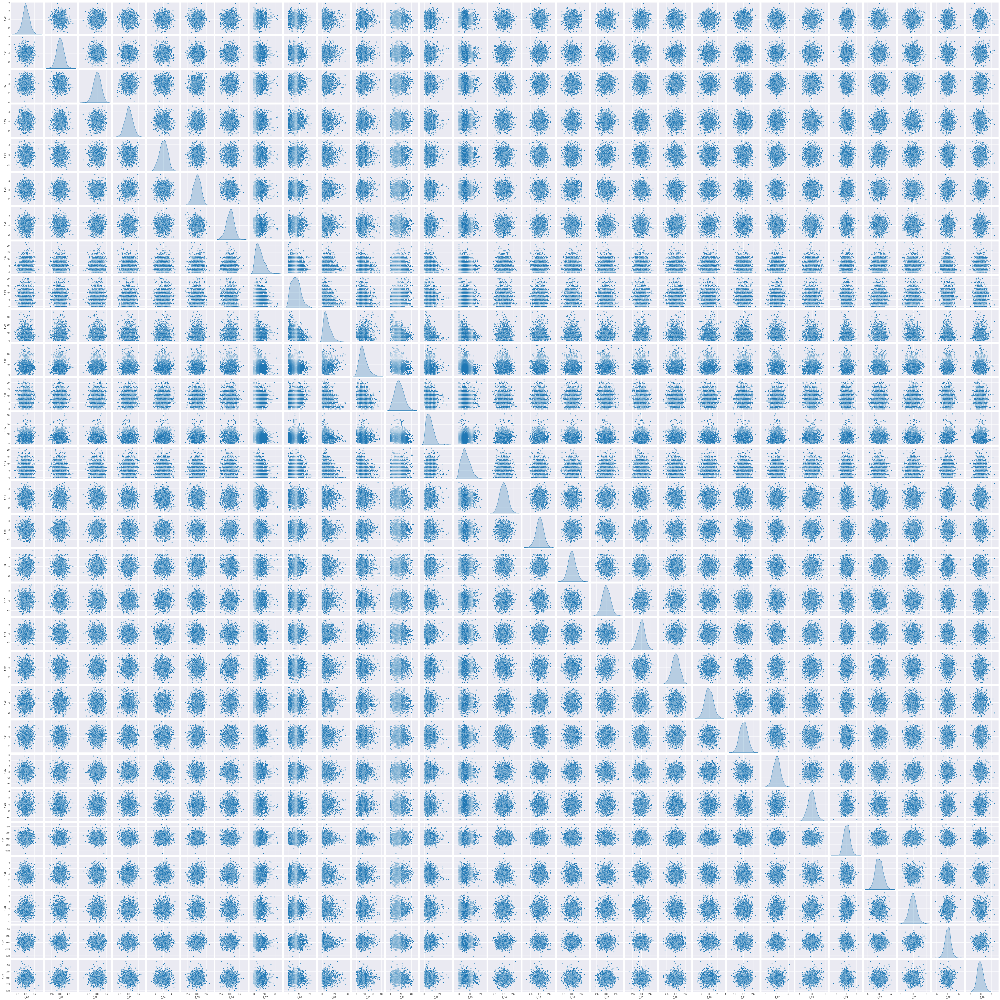

In [3]:
sns.pairplot(df.sample(frac=0.01), diag_kind='kde', plot_kws={'size':0.1,}, height=2);

### Correlations

<AxesSubplot:>

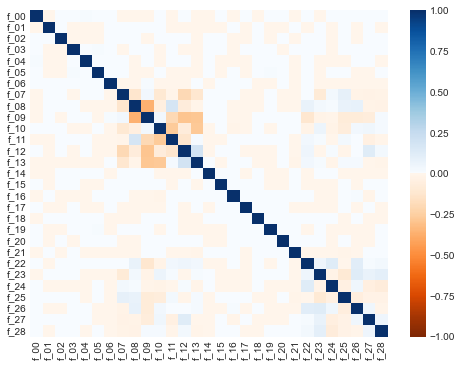

In [9]:
# make cmap
from matplotlib import cm
from matplotlib.colors import ListedColormap

top    = cm.get_cmap('Oranges_r', 128)
bottom = cm.get_cmap('Blues', 128)
newcolors = np.vstack((top(np.linspace(0, 1, 128)), bottom(np.linspace(0, 1, 128))))
cmap = ListedColormap(newcolors, name='OrangeBlue')

# plot corr
plt.figure(figsize=(8,6))
sns.heatmap(df.corr(), cmap=cmap, vmin=-1, vmax=1)

# <span style='background:rgba(70,0,128,.25);border-radius:15px;padding:3px 8px 3px 8px;font-size:0.7em;'> **EDA Insights**
- Shapiro-Wilks Test: Features `f_00` to `f_06`, `f_14` to `f_21` are normally distributed
- Histograms: Features `f_07` to `f_13` have a strong right skew, may benefit from log-transform. We will run these through PowerTransformer
- QQ-plots: Even though the features `f_22` to `f_28` failed the Shapiro-Wilk test, they still appear to be quite close to being normally distributed. 
  - This behaviour could be because these features are made up of a **mixture** of normal distributions. There is not an easy way to verify this however.
  - Similarly, for the discrete features, it could be mixtures of Poisson or binomial distributions.
  - Also the upward curves towards the higher percentiles indicates strong higher bound outliers, also in line with boxplots
- Pearson Correlation Coeffs: some weak intercorrelation within features `f_07` to `f_13`. maybe PCA would help.

# **Feature Selection/Finding optimal n_clusters/Modelling**

## Normalize

In [8]:
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler, PowerTransformer

df_sm = df.sample(frac=0.1, random_state=0)

pwrtfm = PowerTransformer()
df_pwrtfm    = pd.DataFrame(pwrtfm.fit_transform(df), columns=df.columns)
df_sm_pwrtfm = pd.DataFrame(pwrtfm.transform(df_sm), columns=df.columns)

## Outlier Handling

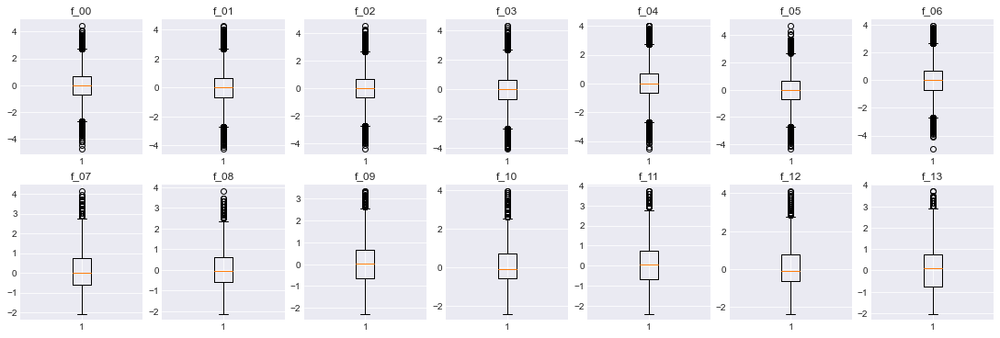

In [39]:
plot_boxplots(df_pwrtfm, (2,7), (15,5))

Since the features have been centered, it's easy to apply outlier handling in terms of multipliers of the stds from mean.

In [10]:
def outliercount(df, max):
    outliers = []
    for col in df.columns:
        len_outliers = len(df[(df[col]>max)|(df[col]<-max)])
        outliers.append( (len_outliers , len_outliers/len(df)) )
    return pd.DataFrame(outliers, index=df.columns, columns=['count','proportion'])

def outlierclip(df, max):  
    for col in df.columns:
        df[col] = df[col].apply(lambda x:max if x>max else x)
        df[col] = df[col].apply(lambda x:-max if x<-max else x)
    return df

**Choose an outlier threshold that doesn't significantly alter the distributions, 2.5 stds seems about right, affecting about 1% of the data.**

In [41]:
# outliercount(df_pwrtfm, 2)
# outliercount(df_pwrtfm, 3)
outliercount(df_pwrtfm, 2.5)

,count,proportion
f_00,1261,0.012867
f_01,1228,0.012531
f_02,1237,0.012622
f_03,1207,0.012316
f_04,1224,0.012490
f_05,1207,0.012316
f_06,1149,0.011724
f_07,277,0.002827
f_08,366,0.003735
f_09,370,0.003776


In [11]:
## APPLY OUTLIER CLAMPING/CLIPPING
df_pwrtfm = outlierclip(df_pwrtfm, 2.5)

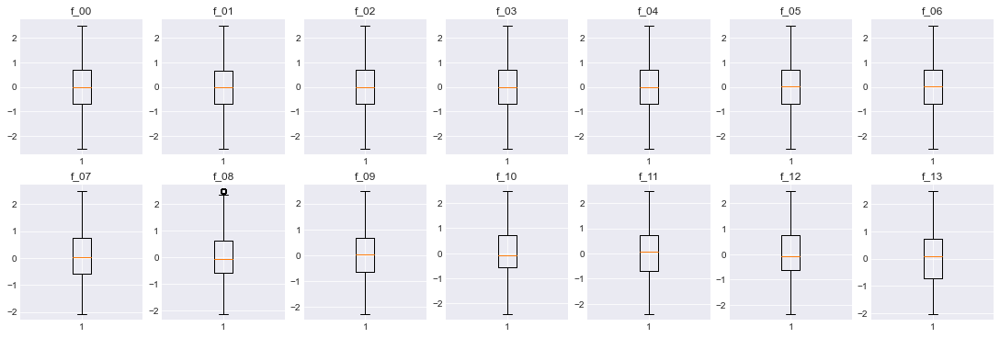

In [43]:
plot_boxplots(df_pwrtfm, (2,7), (15,5))

## PCA Analysis

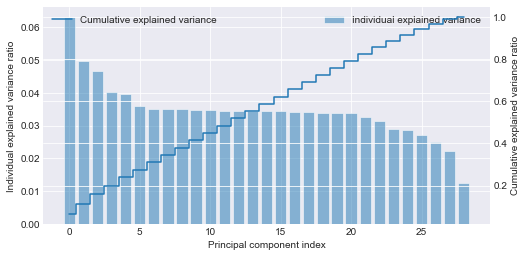

In [16]:
from sklearn.decomposition import PCA

pca = PCA(n_components = 29).fit(df_pwrtfm)

# Determine explained variance using explained_variance_ration_ attribute
exp_var_pca = pca.explained_variance_ratio_

# Cumulative sum of eigenvalues; This will be used to create step plot
# for visualizing the variance explained by each principal component.
cum_sum_eigenvalues = np.cumsum(exp_var_pca)


# Create the visualization plot
fig, ax = plt.subplots(figsize=(8,4))
ax2 = ax.twinx()

ax.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
ax.set_ylabel('Individual explained variance ratio')
ax.set_xlabel('Principal component index')
ax.legend(loc='best')

ax2.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
ax2.set_ylabel('Cumulative explained variance ratio')
ax2.legend(loc='best')

plt.show()

#### Feature Contribution to each Principal Component

C:\tmp\ipykernel_12692\3300306426.py:22: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  plt.colorbar(ticks=[pca.components_.min(), 0, pca.components_.max()]);


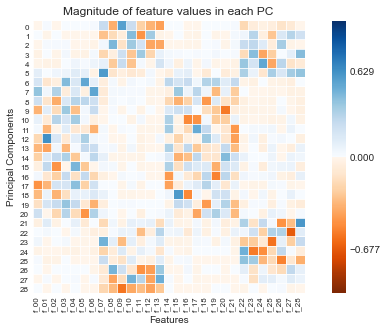

In [18]:
# make cmap
from matplotlib import cm
from matplotlib.colors import ListedColormap

top    = cm.get_cmap('Oranges_r', 128)
bottom = cm.get_cmap('Blues', 128)
newcolors = np.vstack((top(np.linspace(0, 1, 128)), bottom(np.linspace(0, 1, 128))))
cmap = ListedColormap(newcolors, name='OrangeBlue')


fig = plt.figure(figsize=(10, 5))
plt.imshow(pca.components_, interpolation = 'none', cmap = cmap, vmin=-1, vmax=1)

feature_names = list(df.columns)
plt.gca().set_xticks(np.arange(-.5, len(feature_names)-0.5));
plt.gca().set_xticklabels(feature_names, rotation=90, ha='left', fontsize=8);
plt.gca().set_yticks(np.arange(0.5, 29));
plt.gca().set_yticklabels(np.arange(0,29), va='bottom', fontsize=8);
plt.gca().set_ylabel('Principal Components')
plt.gca().set_xlabel('Features')

plt.colorbar(ticks=[pca.components_.min(), 0, pca.components_.max()]);
plt.title('Magnitude of feature values in each PC')
plt.show()

- **It appears that PCA dimension reduction wouldn't be particularly effective, looking at the cumulative explained variance ratio plot.**
- But we can see some grouping in terms of how the features relate. (`f_07-f_13` & `f_22-f_28` tend to be grouped in the same principal components, vs `f_00-f_06` & `f_14-f_21`)

#### Make a 2-component PCA for visualising cluster assignments

In [14]:
df_pcavis = PCA(n_components = 2).fit_transform(df)

## K-means clustering

#### Finding optimum number of clusters using elbow method

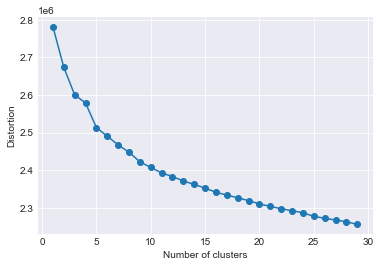

In [19]:
from sklearn.cluster import KMeans, MiniBatchKMeans

# calculate distortion for a range of number of cluster
distortions = []
for i in range(1, 30):
    km = MiniBatchKMeans(
        n_clusters=i, init='random',
        n_init=10, max_iter=300,
        tol=1e-04, random_state=0
    )
    km.fit(df_pwrtfm)
    distortions.append(km.inertia_)

# plot
plt.plot(range(1, 30), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.show()

- no clear elbow. could be between 5-10. we'll go with k=8 for now.

In [26]:
kmeans = KMeans(n_clusters = 8, random_state = 0)
kmeans.fit(df_pwrtfm)
pred_kmeans8 = kmeans.labels_

#### Plot k-Means clusters along first 2 Principal Components

<AxesSubplot:>

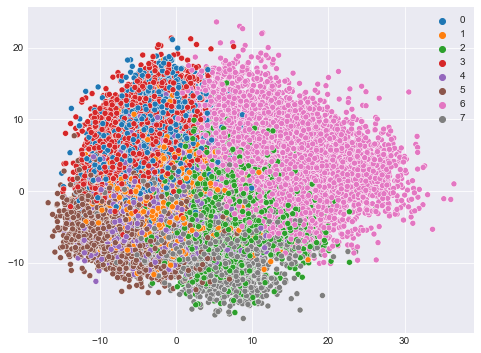

In [34]:
# plot k-means clusters projected onto 2 dims

plt.figure(figsize=(8,6))
sns.scatterplot(x=df_pcavis[:,0], y=df_pcavis[:,1], hue=kmeans.labels_, palette='tab10', ax=plt.gca())

#### Export k-Means labels and evaluation

In [44]:
def export_preds(index, labels, fn):
    predictions = pd.DataFrame({
        'Id'        : index,
        'Predicted' : labels,
    })
    predictions.set_index('Id', inplace=True)
    predictions.to_csv(fn)
    
export_preds(df.index, kmeans.labels_, 'preds-kmeans8-clipped.csv')

## <span style='background:rgba(70,0,128,.25);border-radius:15px;padding:3px 8px 3px 8px;font-size:0.7em;'> **k-Means score**

- Kaggle Scoring using Adjusted Rand Index:

|   | k-Means 8 clusters | k-Means 8 clusters                 | 
|---|--------------------|------------------------------------|
|   | (powertransformer) | (powertransform and clip outliers) |
|Private Score (67% of test data)| 0.24678 | 0.25824          |
|Public score  (33% of test data)| 0.24156 | 0.25427          |
- **So k-Means is not particularly effective in this situation.**

## Gaussian Mixture Model

#### Finding optimum number of clusters using BIC

In [23]:
from sklearn.mixture import GaussianMixture, BayesianGaussianMixture

def plot_gmm_bic_elbow(data, min_n, max_n, runs=3):
    bic_scores = []
    ##? TRAIN GMM OVER 2 TO MAX_N COMPONENTS:
    for n_components in range(min_n, max_n+1):
        print('n_components:{} \t bic_scores:'.format(str(n_components).rjust(2,'0')), end='')
        ##? FOR EACH N_COMPONENTS, RUN SEVERAL TIMES TO GET THE AVERAGE
        bic_scores_n_components = []
        bic_scores_n_components_mean = []
        for run in range(runs):
            gmm = GaussianMixture(n_components=n_components, covariance_type = 'full', n_init=3, random_state=run)
            gmm.fit(data)
            bic = gmm.bic(data)
            bic_scores_n_components.append(bic)
            print('{:.4f}'.format(bic), end='  ')
        print()
        bic_scores.append(bic_scores_n_components)

    bic_df = pd.DataFrame(data = bic_scores)
    bic_df.index = range(min_n,max_n+1)
    
    f,ax = plt.subplots(figsize=(20,7))
    for i in bic_df.columns:
        ax.plot(bic_df.index, bic_df[i].values, label=i, marker='o', linestyle='dashed')

    ax.plot(bic_df.index, bic_df.mean(axis=1).values, color='red', marker='o', label='mean', alpha=0.5, linewidth=4)
    ax.legend()
    ax.set_xticks(range(min_n,max_n+1))

n_components:04 	 bic_scores:7852132.5371  7852182.3090  7852244.2401  
n_components:05 	 bic_scores:7836429.6985  7836405.5530  7836708.0162  
n_components:06 	 bic_scores:7819618.6771  7819419.3532  7816013.2535  
n_components:07 	 bic_scores:7811697.2550  7811629.4691  7811736.4637  
n_components:08 	 bic_scores:7812270.1953  7809945.7835  7810034.5426  
n_components:09 	 bic_scores:7812063.1133  7812076.2099  7812047.4414  
n_components:10 	 bic_scores:7812292.9063  7812284.0259  7812310.5682  
n_components:11 	 bic_scores:7813023.2824  7813015.8449  7812979.5179  
n_components:12 	 bic_scores:7812204.3516  7814683.6771  7805217.3481  
n_components:13 	 bic_scores:7804461.4305  7798708.3609  7814386.7064  
n_components:14 	 bic_scores:7804380.1619  7810975.5297  7815649.9038  
n_components:15 	 bic_scores:7786233.3975  7781507.9110  7791245.3739  
n_components:16 	 bic_scores:7790096.3176  7791027.5316  7797346.5295  
n_components:17 	 bic_scores:7776689.0680  7789926.9623  7777323

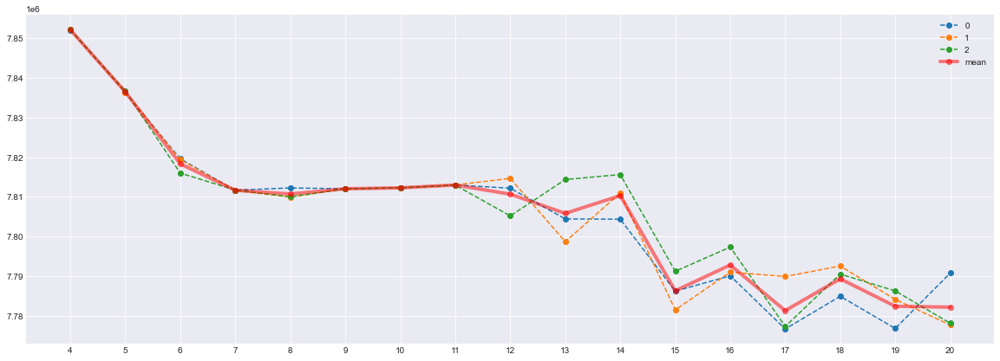

In [24]:
plot_gmm_bic_elbow(df_pwrtfm, min_n=4, max_n=20, runs=3)

- We can see that the optimal number of clusters is also around 7.

#### Train GMM using optimum number of clusters

In [25]:
model_gmm7 = GaussianMixture(n_components=7, random_state=0) 
preds_gmm7 = model_gmm7.fit_predict(df_pwrtfm)

#### Plot feature separation

We can plot the position of the **center** of each cluster to visualise how well each feature is able to **separate** the different clusters.

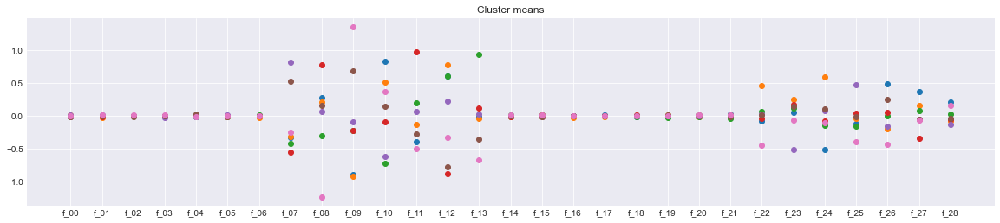

In [26]:
def plot_feature_separation(model, data):
    plt.figure(figsize=(20,4))
    for i in range(model.means_.shape[0]):
        plt.scatter(np.arange(data.shape[1]), model.means_[i])
    plt.xticks(ticks=np.arange(data.shape[1]), labels=data.columns)
    plt.title('Cluster means')
    plt.show()

plot_feature_separation(model_gmm7,  df_pwrtfm)

From this plot we can see that the features *f_00* to *f_06* and *f_14* to *f_21* **don't separate** the clusters at all! This means we might as well **drop** these features as they are not helping us in any way.

## Reduce dataset to only informative columns

In [12]:
from sklearn.decomposition import PCA

informativecols = ['f_07', 'f_08', 'f_09', 'f_10', 'f_11', 'f_12', 'f_13', 'f_22', 'f_23', 'f_24', 'f_25', 'f_26', 'f_27', 'f_28' ]

df_redux                = df[informativecols]
df_redux_sm             = df_sm[informativecols]
df_redux_pwrtfm         = df_pwrtfm[informativecols]
df_redux_sm_pwrtfm      = df_sm_pwrtfm[informativecols]

# pca = PCA(n_components=2)
# df_redux_pwrtfm_pca     = pca.fit_transform(df_redux_pwrtfm)
# df_redux_sm_pwrtfm_pca  = pca.transform(df_redux_sm_pwrtfm)

minmax = MinMaxScaler()
df_redux_minmax         = pd.DataFrame(minmax.fit_transform(df_redux),    columns=df_redux.columns)
df_redux_sm_minmax      = pd.DataFrame(minmax.fit_transform(df_redux_sm), columns=df_redux_sm.columns)
# df_redux_minmax_pca     = pca.fit_transform(df_redux_minmax)
# df_redux_sm_minmax_pca  = pca.transform(df_redux_sm_minmax)

#### Train GMM and BGMM with optimum number of clusters, and only informative features

In [31]:
from sklearn.mixture import BayesianGaussianMixture, GaussianMixture

model_gmm7_redux = GaussianMixture(n_components=7, random_state=0) 
preds_gmm7_redux = model_gmm7_redux.fit_predict(df_pwrtfm)

model_bgmm7_redux = BayesianGaussianMixture(n_components=7, random_state=0, covariance_type='full', max_iter=100, n_init=5, init_params='random')
preds_bgmm7_redux = model_bgmm7_redux.fit_predict(df_pwrtfm)

<AxesSubplot:>

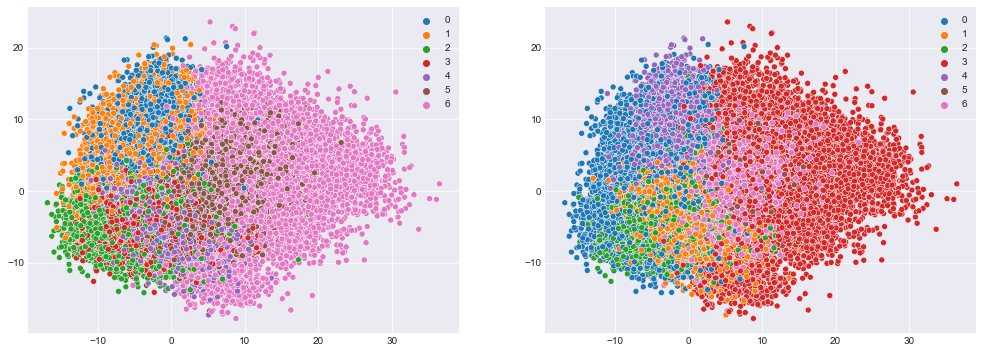

In [33]:
fig,ax = plt.subplots(1,2,figsize=(17,6))
sns.scatterplot(x=df_pcavis[:,0], y=df_pcavis[:,1], hue=preds_gmm7_redux,  palette='tab10', ax=ax[0])
sns.scatterplot(x=df_pcavis[:,0], y=df_pcavis[:,1], hue=preds_bgmm7_redux, palette='tab10', ax=ax[1])

#### Export GMM labels and evaluation

In [30]:
## GMM n_components 7, all features
export_preds(df.index, preds_gmm7, 'preds-gmm7_clipped.csv')

## GMM n_components 7, informative features
export_preds(df.index, preds_gmm7_redux, 'preds-gmm7_redux_clipped.csv')

## BGMM n_components 7, informative features
export_preds(df.index, preds_bgmm7_redux, 'preds-bgmm7_redux_clipped.csv')

## <span style='background:rgba(70,0,128,.25);border-radius:15px;padding:3px 8px 3px 8px;font-size:0.7em;'> **k-Means and GMM scores**
- Kaggle Scoring using Adjusted Rand Index:

MODEL | k-Means 8 clusters | GMM 7 clusters | GMM 7 clusters | GMM 8 clusters | BGMM 7 clusters
-|-|-|-|-|-
features | all | all | informative | all | informative
Private Score (67% test data) | 0.24678 | 0.52555 | 0.52555 | 0.55832 | 0.59953
Public  Score (33% test data) | 0.24156 | 0.52361 | 0.52361 | 0.55777 | 0.59946

- GMM performs better than k-Means.
- BGMM performs better than GMM.
- ~ 430/1250 leaderboards for BGMM score

## BGMM ensemble of 5 models with soft voting

##### Train 5 BGMM models and save each model's predictions and predict_probas

In [3]:
from sklearn.mixture import BayesianGaussianMixture

n_models = 5

bgmms, preds, predprobas = [],[],[]
###? ITERATE AND CREATE MULTIPLE BGMM MODELS
for i in range(n_models):
    bgmm = BayesianGaussianMixture(n_components=7, random_state=i, covariance_type='full', max_iter=300, n_init=3, init_params='random')
    bgmms.append(bgmm)
    pred = bgmm.fit_predict(df_redux_pwrtfm)
    predproba = bgmm.predict_proba(df_redux_pwrtfm)
    preds.append(pred)
    predprobas.append(predproba)

#### Each time a new BGMM model trained, the cluster assignments are arbitrary 
- (e.g. datapoints 1,2,3 are assigned cluster 0 in the first model, but cluster 3 in the subsequent model). 
- Thus we have to create a method to try and map the cluster labels from each subsequent model to the first model's cluster labels. 
- We do this by comparing each model's prediction list, and equate clusters between models if their indices have the highest similarities (since each model will not produce 1:1 predictions). Similarities will be computed using Jaccard Similarity.

In [4]:
from sklearn.preprocessing import OneHotEncoder
ohe = OneHotEncoder(sparse=False)

## JACCARD SIMILARITY COMPARISON. CHECK HOW MUCH OF SET OF INDICES A MATCHES SET OF INDICES B
def indexcompare(a,b):
    combined   = np.union1d(a,b)
    intersects = np.intersect1d(a,b)
    return len(intersects)/len(combined)

n_classes = len(np.unique(preds[0]))

# convert all predictions into one-hot encoded dataframes 
# e.g. [1,2,3..] into [[1,0,0],[0,1,0],[0,0,1]]
df_preds = []
for pred in preds:
    tmp = pd.DataFrame(pred, columns=['pred'])
    tmp['pred'] = tmp['pred'].astype('object')
    tmp = pd.DataFrame(ohe.fit_transform(tmp))
    tmp[tmp.columns] = tmp[tmp.columns].astype('int64')
    df_preds.append(tmp)

# convert all predict_probas into dataframes
df_predprobas = []
for predproba in predprobas:
    df_predprobas.append(pd.DataFrame(predproba))

# df_preds[0] # is the first model.

##? Figure out mappings i.e similar cluster labels across models.
# we will take the first model's cluster labels as default, and create mappings for all other models.
# iterate over every model

print("BEST SIMILARITIES AGAINST MODEL0 LABELS")
clustermappings = []
for model_i in range(1, n_models):
    sims = []
    for firstmodelcurrclass in range(n_classes):
        similarities = []
        for currmodelclass in range(n_classes):
            similarities.append(indexcompare(np.where(df_preds[0].loc[:,firstmodelcurrclass])[0], np.where(df_preds[model_i].loc[:,currmodelclass])[0]))
        for simi in similarities:
            print(f'{simi:.2f}', end='  ')
        print(f'model0 class{firstmodelcurrclass} and model{model_i} class{np.argmax(similarities)} : {np.max(similarities):.4f}')
        sims.append(np.argmax(similarities))
    print()
    clustermappings.append(sims)

BEST SIMILARITIES AGAINST MODEL0 LABELS
0.00  1.00  0.00  0.00  0.00  0.00  0.00  model0 class0 and model1 class1 : 0.9999
1.00  0.00  0.00  0.00  0.00  0.00  0.00  model0 class1 and model1 class0 : 1.0000
0.00  0.00  0.00  0.00  1.00  0.00  0.00  model0 class2 and model1 class4 : 0.9999
0.00  0.00  0.00  0.00  0.00  1.00  0.00  model0 class3 and model1 class5 : 0.9989
0.00  0.00  1.00  0.00  0.00  0.00  0.00  model0 class4 and model1 class2 : 0.9998
0.00  0.00  0.00  0.00  0.00  0.00  1.00  model0 class5 and model1 class6 : 0.9998
0.00  0.00  0.00  1.00  0.00  0.00  0.00  model0 class6 and model1 class3 : 0.9995

0.00  0.00  0.00  0.00  0.00  1.00  0.00  model0 class0 and model2 class5 : 0.9997
0.00  0.00  0.00  0.00  0.00  0.00  1.00  model0 class1 and model2 class6 : 0.9998
0.00  0.00  0.00  0.00  1.00  0.00  0.00  model0 class2 and model2 class4 : 0.9996
0.00  1.00  0.00  0.00  0.00  0.00  0.00  model0 class3 and model2 class1 : 0.9961
0.00  0.00  0.00  1.00  0.00  0.00  0.00  mode

In [5]:
## REMAP PREDICTIONS USING CLUSTER MAPPINGS
for i in range(len(clustermappings)):
    columns = list(df_predprobas[i+1].columns)
    df_predprobas[i+1].columns = columns
    df_predprobas[i+1] = df_predprobas[i+1][clustermappings[i]]
    df_predprobas[i+1].columns = columns
    df_predprobas[i+1]

    columns = list(df_preds[i+1].columns)
    df_preds[i+1].columns = columns
    df_preds[i+1] = df_preds[i+1][clustermappings[i]]
    df_preds[i+1].columns = columns
    df_preds[i+1]

- Now that we have the mappings of cluster labels across the models, we can sum up and average their predict_probas

In [6]:
## AVERAGE PROBAS ACROSS ALL MODELS
df_predprobas_sum = df_predprobas[0] + df_predprobas[1] + df_predprobas[2] + df_predprobas[3] + df_predprobas[4]
df_predprobas_sum /=5
df_predprobas_sum.idxmax()

0    69147
1    83036
2    15964
3    58447
4    82234
5    62027
6    43383
dtype: int64

In [7]:
pred_bgmm_ensemble = df_predprobas_sum.idxmax(axis=1)

In [39]:
## BGMM ensemble, n_components 7, informative features
export_preds(df.index, pred_bgmm_ensemble, 'preds-bgmm_ensemble5.csv')

## <span style='background:rgba(70,0,128,.25);border-radius:15px;padding:3px 8px 3px 8px;font-size:0.7em;'> **BGMM ensemble (with soft voting) scores**
- Kaggle Scoring using Adjusted Rand Index:
- BGMM ensemble of 5 models, summing of predict_probas for cluster assignment:
    - Public score:  0.60606
    - Private score: 0.60786

## Semi-supervised: HistGBM

- We will take rows where the mean predict_probas were high across the 5 models, to be 'confident predictions'.
- Using that subset of confident predictions, we will train a histgbm model. Thereafter, hopefully the histgbm model is able to make better predictions on the rows where the BGMM prediction probabilities were lower.

In [115]:
df_pwrtfm = pd.DataFrame(PowerTransformer().fit_transform(df), columns=df.columns)

In [8]:
## DECIDE ON A CUT-OFF PREDICT_PROBA THRESHOLD FOR WHICH TO CONSIDER AS 'CONFIDENT PREDICTIONS' AND ONLY FEED CLASSIFIER THOSE DATAPOINTS
cutoff=0.8
sumrows=0

for col in df_predprobas_sum.columns:
    sumrows += len(df_predprobas_sum[df_predprobas_sum[col]>cutoff])

sumrows

59697

In [9]:
## CHECK LENGTH OF EACH CLASS
indices = []
for col in df_predprobas_sum.columns:
    indices.append(df_predprobas_sum[df_predprobas_sum[col]>cutoff].index)

[len(i) for i in indices]

[7240, 10648, 9636, 2840, 9165, 10621, 9547]

In [12]:
## ASSIGN LABELS TO DATASET FOR CLASSIFIER
for i,idx in enumerate(indices):
    df_pwrtfm.loc[idx, 'label'] = i


X = df_pwrtfm[df_pwrtfm['label'].notna()]
y = X.pop('label') 

In [45]:
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.model_selection import GridSearchCV

param_grid = {
    'max_depth' : [5],
}

hgbm = HistGradientBoostingClassifier(max_iter=150)
hgbm_gs = GridSearchCV(hgbm, param_grid, n_jobs=-1, scoring='accuracy').fit(X,y)

print(hgbm_gs.best_params_, hgbm_gs.best_score_)

{'max_depth': 5} 0.9977935915800826


In [15]:
_ = df_pwrtfm.pop('label')

In [16]:
pred_hgbm = hgbm_gs.predict(df_pwrtfm)
export_preds(df.index, pred_hgbm, 'preds-hgbm_cutoff0.8_depth5_acc.csv')

<AxesSubplot:>

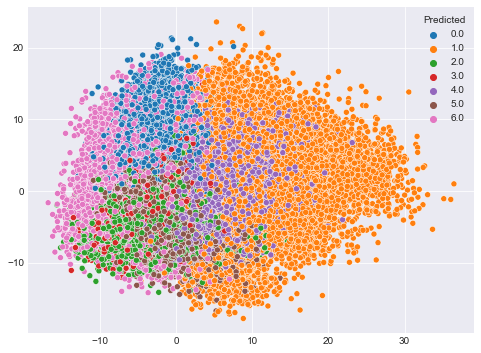

In [36]:
fig,ax = plt.subplots(figsize=(8,6))
sns.scatterplot(x=df_pcavis[:,0], y=df_pcavis[:,1], hue=pred_hgbm, palette='tab10', ax=ax)

## <span style='background:rgba(70,0,128,.25);border-radius:15px;padding:3px 8px 3px 8px;font-size:0.7em;'> **Semi Supervised: HistGBM scores**
- (Using combined predict_proba from 5 BGMM models, to label and train HistGBM)
  - Private Score: 0.61208
  - Public score: 0.61313
  - ~ 317/1253 leaderboards

## DBSCAN

- DBSCAN had poor performance, as density seems quite homogeneous throughout. (This was also observed in bivariate plots along each pair of features)

#### Finding optimal epsilon value
- The optimal value for epsilon will be found at the point of maximum curvature.

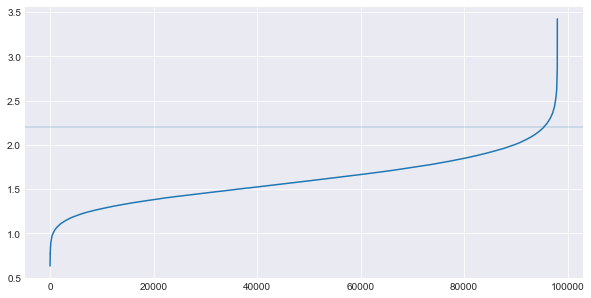

In [9]:
from sklearn.neighbors import NearestNeighbors

neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(df_redux_pwrtfm)
distances, indices = nbrs.kneighbors(df_redux_pwrtfm)

distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.figure(figsize=(10,5))
plt.axhline(2.2, alpha=0.2)
plt.plot(distances)

- From the above graph, it's not likely that DBSCAN will be effective. If we set an eps value of 2.2, it looks like almost all the points will be within that boundary from each other. (the elbow is almost vertical)
- If we were to try again but using minmaxscaler normalization instead (though I expect the results would be the same.):

In [10]:
from sklearn.preprocessing import MinMaxScaler

df_redux_minmax = MinMaxScaler((-1,1)).fit_transform(df_redux)

from sklearn.neighbors import NearestNeighbors

neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(df_redux_pwrtfm)
distances, indices = nbrs.kneighbors(df_redux_minmax)

distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.figure(figsize=(10,5))
plt.axhline(1.7, alpha=0.2)
plt.plot(distances)

c:\Anaconda\envs\python\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but NearestNeighbors was fitted with feature names
  warnings.warn(


- For comparison, here's sample blobs with varying densities, and the corresponding distance plots, for estimating epsilon value. (the elbow is less vertical, meaning there is some cluster separation)

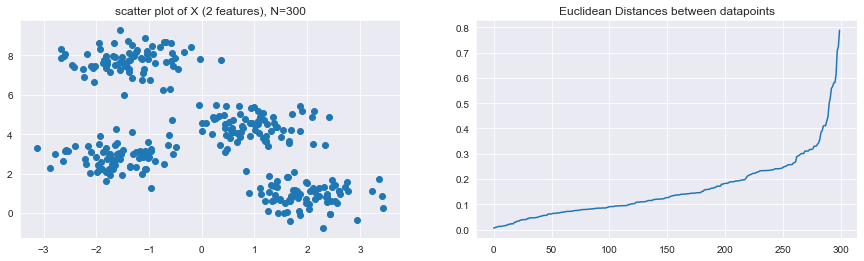

In [ ]:
from sklearn.datasets import make_blobs
from sklearn.neighbors import NearestNeighbors

X, y = make_blobs(n_samples=300, centers=4, cluster_std=0.60, random_state=0)
fig, ax = plt.subplots(1,2, figsize=(15,4))
ax[0].scatter(X[:,0], X[:,1])
ax[0].set_title('scatter plot of X (2 features), N=300')
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(X)
distances, indices = nbrs.kneighbors(X)

distances = np.sort(distances, axis=0)
distances = distances[:,1]

ax[1].plot(distances)
ax[1].set_title('Euclidean Distances between datapoints')
plt.show()


#### Train DBSCAN

In [11]:
from sklearn.cluster import DBSCAN

# define the model
dbscan = DBSCAN(eps=2.2, min_samples=5)
dbscan.fit(df_redux_pwrtfm)
preds_dbscan = dbscan.labels_

export_preds(df.index, preds_dbscan, 'preds-dbscan.csv')

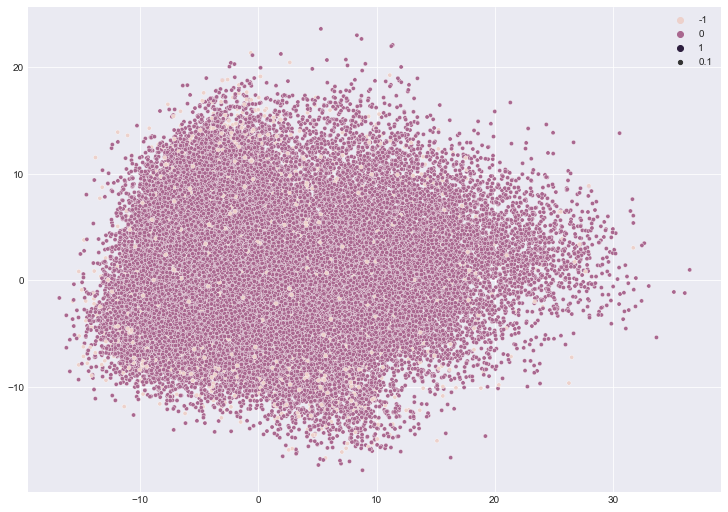

classes: [-1  0  1]
num classes: 3
Class -1 : 3109 items
Class 0 : 94886 items
Class 1 : 5 items


In [21]:
### PLOT LABELS AGAINST SEVERAL FEATURE DIMENSIONS
fig, ax=plt.subplots(figsize=(10,7), constrained_layout=True)
sns.scatterplot(x=df_pcavis[:,0], y=df_pcavis[:,1], hue=preds_dbscan, size=0.1, ax=ax)

plt.show()
# sns.scatterplot(df_pca[:,0], df_pca[:,1], hue=preds_dbscan)
print('classes: {}'.format(np.unique(preds_dbscan)))
print('num classes: {}'.format(len(np.unique(preds_dbscan))))

for i in np.unique(preds_dbscan):
    print('Class {} : {} items'.format(i, len(preds_dbscan[preds_dbscan==i])))

- **DBSCAN is not effective for this, as dataset seems to be homogeneous density throughout, it is just clustering everything into 1 cluster, with some outlier clusters.**
- Public score: 0.00060
- Public score: 0.00085

## Meanshift GMM

- Training takes quite long. Not able to tune to get meaningful performance.

In [22]:
from sklearn.cluster import estimate_bandwidth
bandwidth = estimate_bandwidth(df_redux_pwrtfm, n_samples=20000)
print(bandwidth)

4.650059310397168


- above, we found an estimated bandwidth of 4.682364685517767
- using that and training a MeanShift below (with binning to speed up computation), it only produced 1 single cluster.

In [ ]:
from sklearn.cluster import MeanShift
import numpy as np

meanshift = MeanShift(bandwidth=bandwidth, bin_seeding=True, min_bin_freq=5, max_iter=1000).fit(df_redux_pwrtfm)
classes = np.unique(meanshift.labels_)
print(len(classes), classes)

- tuning bandwidth down to 2, we have 18 clusters. but it doesn't look all that meaningful:


| label | 0 | 1 | 2 | 3 | 4 | 5 | 6 | 7 | 8 | 9 | 10 | 11 | 12 | 13 | 14 | 15 | 16 | 17 |
|-------|---|---|---|---|---|---|---|---|---|---|----|----|----|----|----|----|----|----|
| len | 55628 | 3256 | 8767 | 4458 | 2951 | 4591 | 2298 | 3941 | 1106 | 1071 | 1853 | 1398 | 915 | 2188 | 567 | 1799 | 524 | 689 | 

In [24]:
from sklearn.cluster import MeanShift
import numpy as np

meanshift = MeanShift(bandwidth=2, bin_seeding=True, min_bin_freq=5, max_iter=1000).fit(df_redux_pwrtfm) # bandwidth=bandwidth,
classes = np.unique(meanshift.labels_)
print(len(classes), classes)

export_preds(df.index, meanshift.labels_, 'preds-meanshift_redux.csv')


13 [ 0  1  2  3  4  5  6  7  8  9 10 11 12]


c:\Anaconda\envs\python\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:>

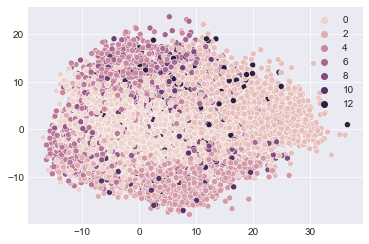

In [25]:
sns.scatterplot(df_pcavis[:,0],df_pcavis[:,1],hue=meanshift.labels_)

- **MeanShift not effective.**
- Private score: 0.06243
- Public score: 0.06051

## Agglomerative clustering

- Took too long, skipped.

In [251]:
from sklearn.cluster import AgglomerativeClustering

cls = AgglomerativeClustering(n_clusters = 7, linkage='ward')
pred_agg = cls.fit_predict(df_redux_pwrtfm)
# stopped after 570min
export_preds(df.index, pred_agg, 'preds-agg.csv')

In [ ]:
from scipy.cluster.hierarchy import ward, dendrogram
plt.figure(figsize=(30,18))
dendrogram(ward(df_sm))
plt.show()

In [ ]:
sns.scatterplot(df_pcavis[:,0], df_pcavis[:,1], hue=pred_agg)

## Birch

- Poor performance. Training takes too long to tune.

In [246]:
from sklearn.cluster import Birch

# df_small = df_redux_pwrtfm.sample(frac=0.1, random_state=0)
# df_small_vis = PCA(n_components=2).fit_transform(df_small)

brc = Birch(n_clusters=7)
brc.fit(df_redux_pwrtfm)
pred_birch = brc.labels_

export_preds(df.index, pred_birch, 'preds-birch.csv')
# 259min

c:\Anaconda\envs\python\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:>

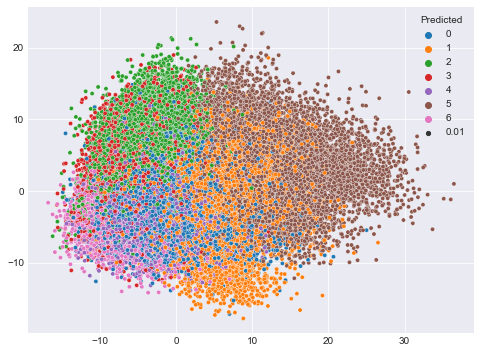

In [42]:
fig,ax = plt.subplots(figsize=(8,6))
sns.scatterplot(df_pcavis[:,0],df_pcavis[:,1],hue=pred_birch, ax=ax, palette='tab10', size=0.01*np.ones(len(pred_birch)))

Birch
- Private score: 0.32239
- Public score: 0.32035

# **Visualise Feature Distributions based on clusters**

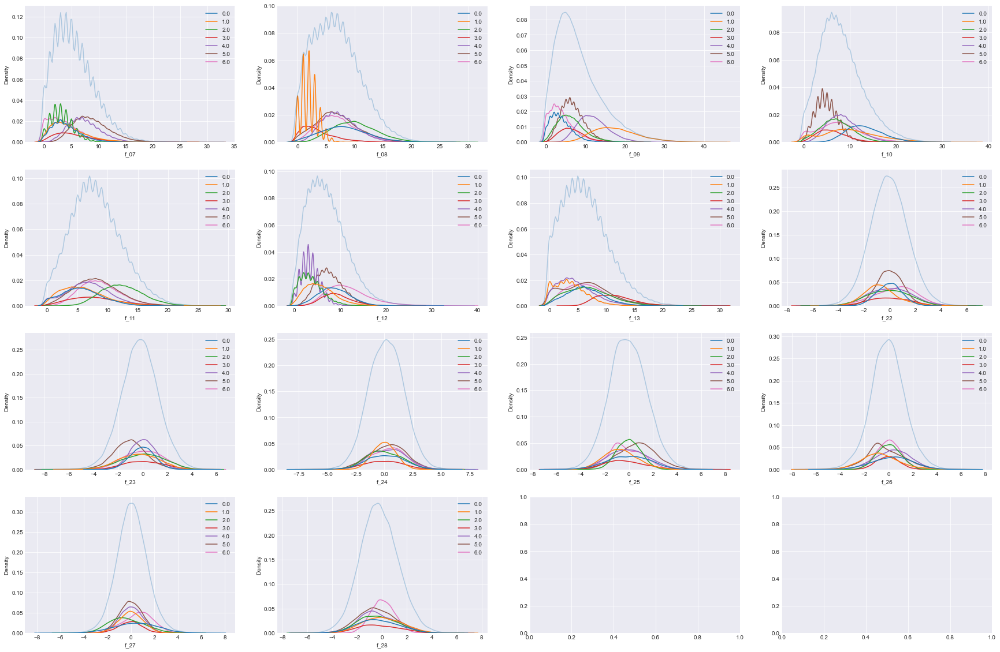

In [ ]:
fig,axs=plt.subplots(4,4,figsize=(30,20))

for col,ax in zip(informativecols,axs.ravel()):
    sns.kdeplot(df[col], hue=pred_hgbm, palette='tab10',ax=ax)
    sns.kdeplot(df[col], ax=ax, alpha=0.3)
    

# **Visualise predicted clusters with t-SNE**

## t-SNE

#### Find suitable perplexity param

- Tuning this took too long for my machine, would've wanted to explore further perplexity values of [23,38] for example, and find any point where the clusters separate cleanly, but processing just took too long.
- Will just go with perplexity of 24.

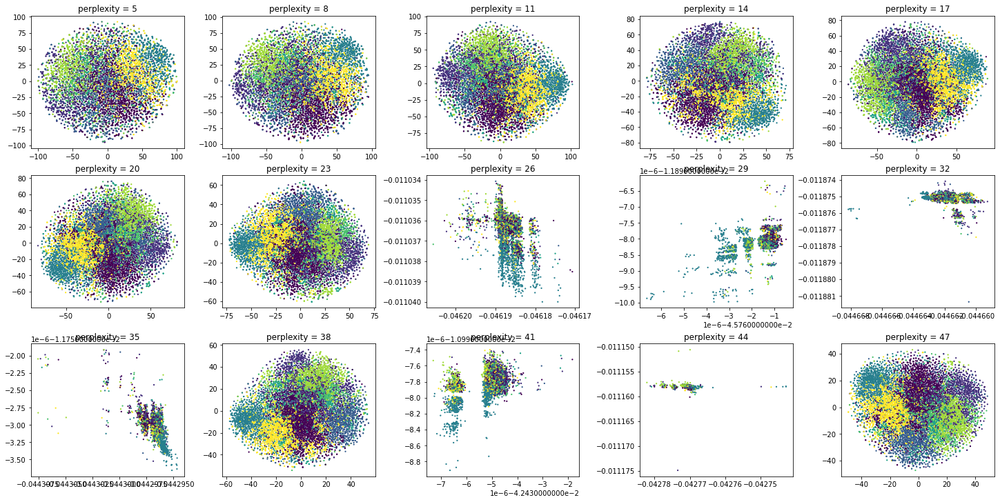

In [ ]:
from sklearn.manifold import TSNE
import plotly.express as px

tsnes = []
df_tsnes = []
perplexities = np.arange(5,50,3)

for perplexity in perplexities:
    tsne1=TSNE(random_state = 0, init='pca', perplexity=perplexity)
    df_tsne1=tsne1.fit_transform(df_sm_pwrtfm)
    tsnes.append(tsne1)
    df_tsnes.append(df_tsne1)

fig,axs = plt.subplots(3,5, figsize=(20,10), constrained_layout=True)
for df,ax,pplx in zip(df_tsnes,axs.ravel(),perplexities):
    ax.scatter(df[:,0], df[:,1], s=1.5, c=preds_gmm)
    ax.set_title('perplexity = {}'.format(pplx))
plt.show()

In [15]:
from sklearn.manifold import TSNE
import plotly.express as px

pplx = 24
tsne1=TSNE(random_state = 0, init='pca', perplexity=pplx)
df_tsne1=tsne1.fit_transform(df_redux_pwrtfm)

c:\Anaconda\envs\python\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
c:\Anaconda\envs\python\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


#### Visualisation of HistGBM clusters

<AxesSubplot:>

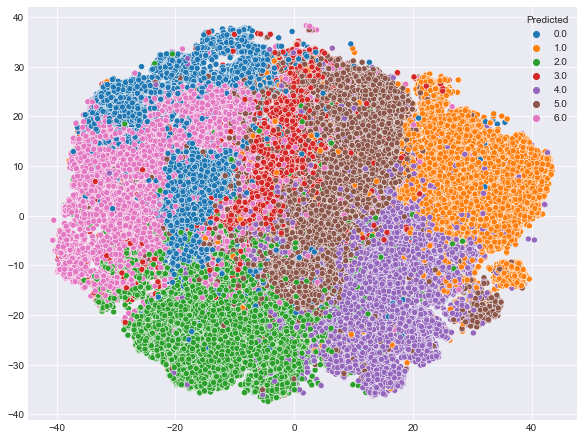

In [43]:
fig,ax = plt.subplots(figsize=(8,6), constrained_layout=True)
sns.scatterplot(x=df_tsne1[:,0], y=df_tsne1[:,1], hue=pred_hgbm, palette='tab10', ax=ax)


#### Visualisation of Bayesian GMM (ensemble, soft voting) clusters

<AxesSubplot:>

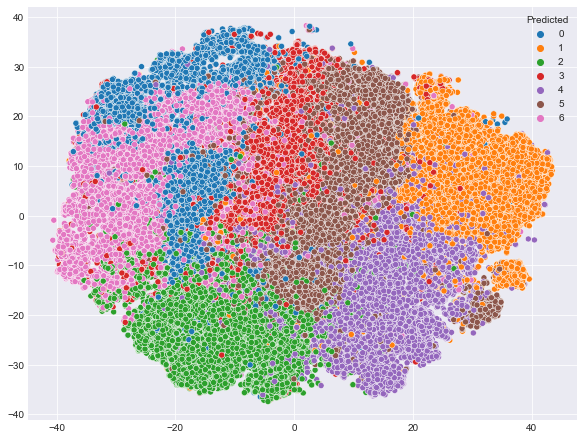

In [44]:
fig,ax = plt.subplots(figsize=(8,6), constrained_layout=True)
sns.scatterplot(x=df_tsne1[:,0], y=df_tsne1[:,1], hue=pred_bgmm_ensemble, palette='tab10', ax=ax)

#### Visualisation of k-Means clusters

<AxesSubplot:>

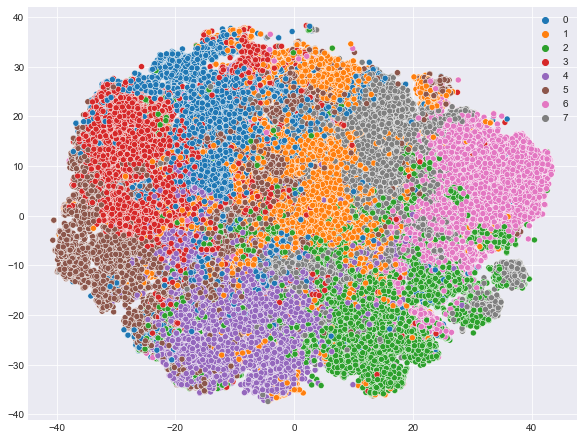

In [45]:
fig,ax = plt.subplots(figsize=(8,6), constrained_layout=True)
sns.scatterplot(x=df_tsne1[:,0], y=df_tsne1[:,1], hue=kmeans.labels_, palette='tab10', ax=ax) 

# **Conclusions**

- Need to learn more on semi-supervised iterative methods of improving classification performance..